# Group 14 - Project FP01
## Time series anomaly detection - LSTM-AD

In [25]:
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf

from dataset import *
from plots import *
from metrics import *
from models_functions import *

# Set style for matplotlib
plt.style.use("Solarize_Light2")

import plotly.io as pio
pio.renderers.default = "notebook_connected"

In [26]:
# Path to the root directory of the dataset
ROOTDIR_DATASET_NORMAL =  '../dataset/normal'
ROOTDIR_DATASET_ANOMALY = '../dataset/collisions'

# TF_ENABLE_ONEDNN_OPTS=0 means that the model will not use the oneDNN library for optimization

import os
os.environ['TF_ENABLE_ONEDNN_OPTS'] = '0'

#### Variours parameters

In [27]:
#freq = '1.0'
#freq = '0.1'
#freq = '0.01'
freq = '0.005'

file_name_normal = "_20220811_rbtc_"
file_name_collisions = "_collision_20220811_rbtc_"

recording_normal = [0, 2, 3, 4]
recording_collisions = [1, 5]

freq_str = freq.replace(".", "_")
features_folder_normal = f"./features/normal{freq_str}/"
features_folder_collisions = f"./features/collisions{freq_str}/"

### Data

In [28]:
df_features_normal, df_normal_raw, _ = get_dataframes(ROOTDIR_DATASET_NORMAL, file_name_normal, recording_normal, freq, f"{features_folder_normal}")
df_features_collisions, df_collisions_raw, df_collisions_raw_action = get_dataframes(ROOTDIR_DATASET_ANOMALY, file_name_collisions, recording_collisions, freq, f"{features_folder_collisions}1_5/")
df_features_collisions_1, df_collisions_raw_1, df_collisions_raw_action_1 = get_dataframes(ROOTDIR_DATASET_ANOMALY, file_name_collisions, [1], freq, f"{features_folder_collisions}1/")
df_features_collisions_5, df_collisions_raw_5, df_collisions_raw_action_5 = get_dataframes(ROOTDIR_DATASET_ANOMALY, file_name_collisions, [5], freq, f"{features_folder_collisions}5/")

Loading data.
Found 31 different actions.
Loading data done.

Loading features from file.
--- 0.06820011138916016 seconds ---
Loading data.
Found 31 different actions.
Loading data done.

Loading features from file.
--- 0.03364229202270508 seconds ---
Loading data.
Found 31 different actions.
Loading data done.

Loading features from file.
--- 0.024097442626953125 seconds ---
Loading data.
Found 31 different actions.
Loading data done.

Loading features from file.
--- 0.029073238372802734 seconds ---


In [29]:
X_train, y_train, X_test, y_test, df_test = get_train_test_data(df_features_normal, df_features_collisions, full_normal=True)
X_train_1, y_train_1, X_test_1, y_test_1, df_test_1 = get_train_test_data(df_features_normal, df_features_collisions_1, full_normal=True)
X_train_5, y_train_5, X_test_5, y_test_5, df_test_5 = get_train_test_data(df_features_normal, df_features_collisions_5, full_normal=True)

c:\Users\VG User\Documents\GitHub\MLinAPP-FP01-14\.venv\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but VarianceThreshold was fitted with feature names

c:\Users\VG User\Documents\GitHub\MLinAPP-FP01-14\.venv\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but VarianceThreshold was fitted with feature names

c:\Users\VG User\Documents\GitHub\MLinAPP-FP01-14\.venv\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but VarianceThreshold was fitted with feature names



### Collisions

In [30]:
collisions_rec1, collisions_init1 = get_collisions('1', ROOTDIR_DATASET_ANOMALY)
collisions_rec5, collisions_init5 = get_collisions('5', ROOTDIR_DATASET_ANOMALY)

# Merge the collisions of the two recordings in one dataframe
collisions_rec = pd.concat([collisions_rec1, collisions_rec5])
collisions_init = pd.concat([collisions_init1, collisions_init5])

In [31]:
collisions_zones, y_collisions = get_collisions_zones_and_labels(collisions_rec, collisions_init, df_features_collisions)
collisions_zones_1, y_collisions_1 = get_collisions_zones_and_labels(collisions_rec1, collisions_init1, df_features_collisions_1)
collisions_zones_5, y_collisions_5 = get_collisions_zones_and_labels(collisions_rec5, collisions_init5, df_features_collisions_5)

## LSTM-AD for Anomaly Detection in Time Series Data

In [32]:
from algorithms.lstm_ad import LSTMAD

def prepare_data_for_lstm(data, len_in):
    """
    Prepare data for LSTM-AD by concatenating every len_in rows.
    """
    n_features = data.shape[1]
    n_samples = data.shape[0] // len_in
    prepared_data = data.iloc[:n_samples * len_in].values.reshape(n_samples, -1)
    return pd.DataFrame(prepared_data, index=data.index[len_in-1:len_in*n_samples:len_in])

# CURRENTLY FUCKS UP FOR VALUES OF LEN_IN AND LEN_OUT DIFFERENT FROM 1
len_in = 1
X_train_lstm = prepare_data_for_lstm(X_train, len_in)
print(X_train_lstm.shape)

classifier = LSTMAD(
    len_in=len_in,         # Input sequence length
    len_out=1,             # Output sequence length (prediction horizon)
    num_epochs=100,         # Number of training epochs
    lr=1e-2,               # Learning rate
    batch_size=1,          # Batch size (usually 1 for time series)
    seed=42,               # Random seed for reproducibility
    gpu=None,              # Set to None for CPU, or specify GPU index if available
    details=True           # Set to True to get detailed predictions
)

# Train the LSTM on normal data
classifier.fit(X_train_lstm)
print("LSTM-AD training completed.")


(973, 123)


100%|██████████| 100/100 [00:48<00:00,  2.07it/s]

LSTM-AD training completed.


### Predictions

Anomaly prediction completed.
Number of anomalies detected: 1 with threshold 19114608318.430008, std
Number of anomalies detected: 87 with threshold 5423.441997258433, mad
Number of anomalies detected: 16 with threshold 16283.848813094595, percentile
Number of anomalies detected: 15 with threshold 16650.689735735974, IQR
Number of anomalies detected: 306 with threshold 0.0, zero

choosen threshold type: mad, with value: 5423.4420
F1 Score: 0.8021
Accuracy: 0.8758
Precision: 0.8851
Recall: 0.7333
              precision    recall  f1-score   support

           0       0.87      0.95      0.91       201
           1       0.89      0.73      0.80       105

    accuracy                           0.88       306
   macro avg       0.88      0.84      0.86       306
weighted avg       0.88      0.88      0.87       306

ROC AUC Score: 0.9250


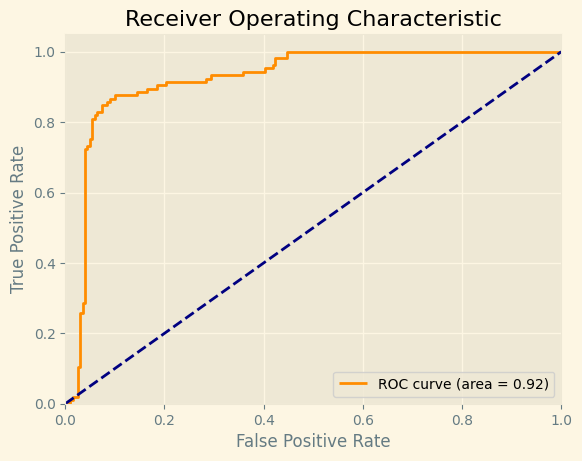

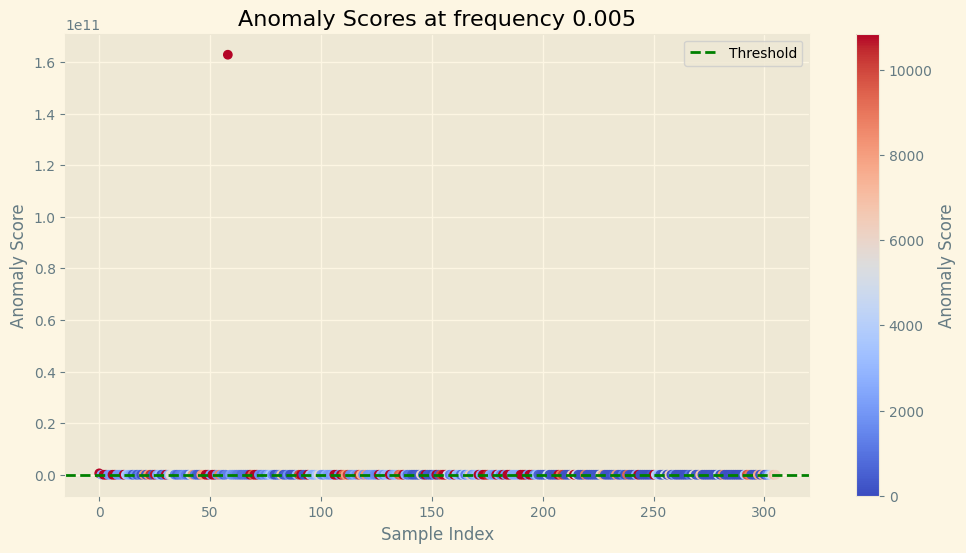

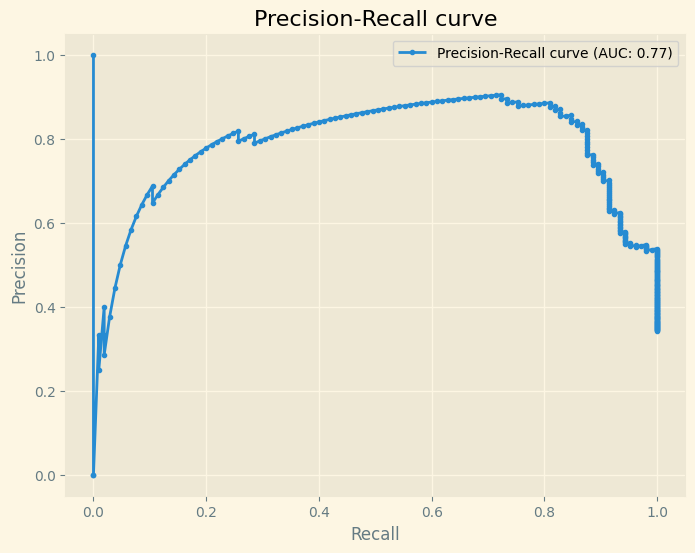

Anomalies detected: 87
Best threshold: 3358.3611 | F1 Score: 0.8517 | Precision: 0.8558 | Recall: 0.8476
Anomalies detected with best threshold: 104

	-------------------------------------------------------------------------------------

Anomaly prediction completed.
Number of anomalies detected: 1 with threshold 26342956648.3772, std
Number of anomalies detected: 29 with threshold 3639.8151947713945, mad
Number of anomalies detected: 9 with threshold 14131.932994390048, percentile
Number of anomalies detected: 19 with threshold 6455.727051343221, IQR
Number of anomalies detected: 164 with threshold 0.0, zero

choosen threshold type: mad, with value: 3639.8152
F1 Score: 0.5625
Accuracy: 0.8293
Precision: 0.6207
Recall: 0.5143
              precision    recall  f1-score   support

           0       0.87      0.91      0.89       129
           1       0.62      0.51      0.56        35

    accuracy                           0.83       164
   macro avg       0.75      0.71      0.73   

c:\Users\VG User\Documents\GitHub\MLinAPP-FP01-14\src\models_funtions.py:67: RuntimeWarning:

invalid value encountered in divide



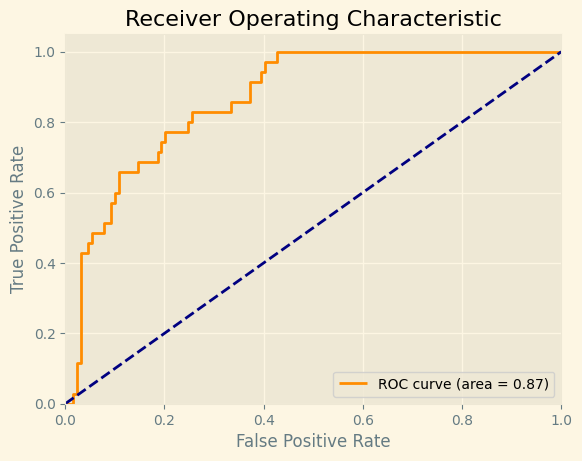

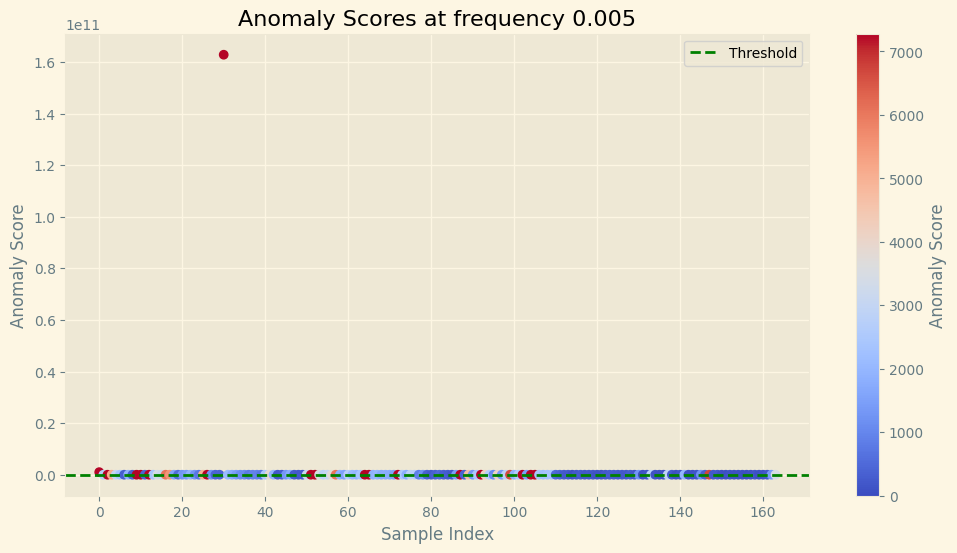

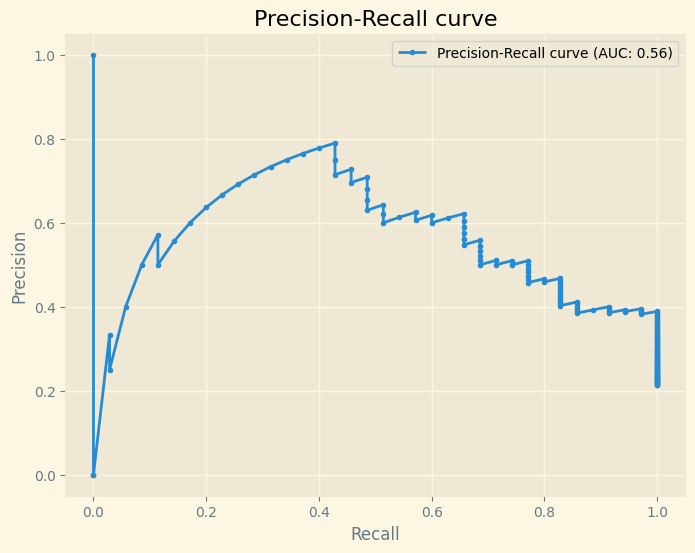

Anomalies detected: 29
Best threshold: 2945.0824 | F1 Score: 0.6389 | Precision: 0.6216 | Recall: 0.6571
Anomalies detected with best threshold: 37

	-------------------------------------------------------------------------------------

Anomaly prediction completed.
Number of anomalies detected: 5 with threshold 17205.103832527217, std
Number of anomalies detected: 22 with threshold 12063.30061000117, mad
Number of anomalies detected: 8 with threshold 15722.268143256404, percentile
Number of anomalies detected: 2 with threshold 22545.5562977121, IQR
Number of anomalies detected: 141 with threshold 0.0, zero

choosen threshold type: mad, with value: 12063.3006
F1 Score: 0.4872
Accuracy: 0.7163
Precision: 0.8636
Recall: 0.3393
              precision    recall  f1-score   support

           0       0.69      0.96      0.80        85
           1       0.86      0.34      0.49        56

    accuracy                           0.72       141
   macro avg       0.78      0.65      0.65    

c:\Users\VG User\Documents\GitHub\MLinAPP-FP01-14\src\models_funtions.py:67: RuntimeWarning:

invalid value encountered in divide



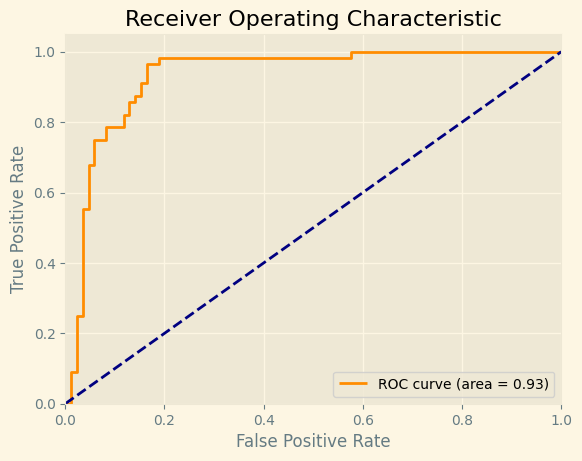

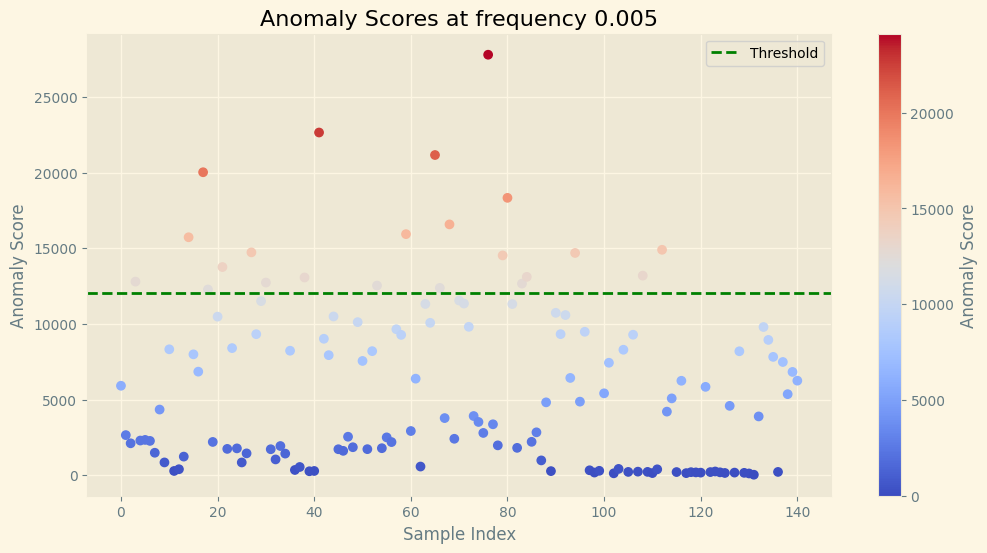

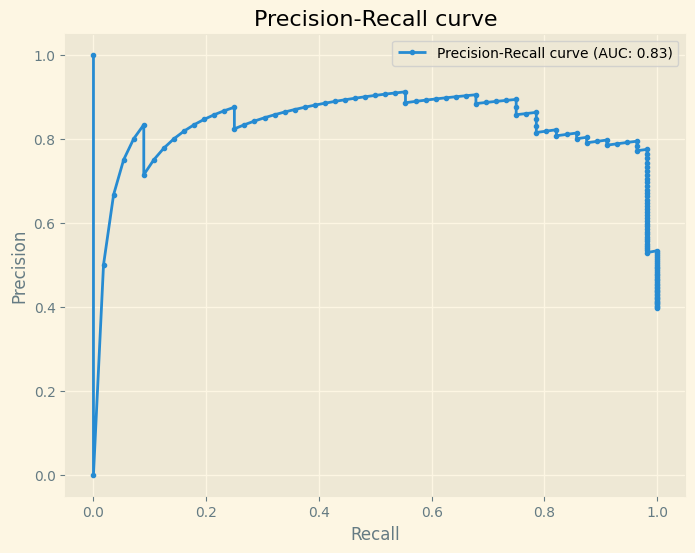

Anomalies detected: 22
Best threshold: 4815.3355 | F1 Score: 0.8710 | Precision: 0.7941 | Recall: 0.9643
Anomalies detected with best threshold: 68

	-------------------------------------------------------------------------------------



c:\Users\VG User\Documents\GitHub\MLinAPP-FP01-14\src\models_funtions.py:67: RuntimeWarning:

invalid value encountered in divide



In [33]:
df_test = get_statistics(X_test, y_collisions, classifier, df_test, freq, threshold_type="mad")
df_test_1 = get_statistics(X_test_1, y_collisions_1, classifier, df_test_1, freq, threshold_type="mad")
df_test_5 = get_statistics(X_test_5, y_collisions_5, classifier, df_test_5, freq, threshold_type="mad")

In [34]:
plot_anomalies_true_and_predicted(df_collisions_raw, df_collisions_raw_action, collisions_zones, df_test, title="Collisions zones vs predicted zones for both recordings")

In [35]:
plot_anomalies_true_and_predicted(df_collisions_raw_1, df_collisions_raw_action_1, collisions_zones_1, df_test_1, title="Collisions zones vs predicted zones for recording 1")

In [36]:
plot_anomalies_true_and_predicted(df_collisions_raw_5, df_collisions_raw_action_5, collisions_zones_5, df_test_5, title="Collisions zones vs predicted zones for recording 5")